In [ ]:
# Necessary imports
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.models import vgg19
from torch.utils.data import Dataset
import os
import config
from PIL import Image
from torchvision.utils import save_image
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt



# Model Architecture referenced from
https://arxiv.org/abs/1609.04802

![image.png](attachment:a121faa6-7b65-44bd-8daf-474f15f39fc8.png)

In [ ]:
class ConvBlock(nn.Module):
    def __init__(
        self,
        in_channels,
        out_channels,
        discriminator=False,
        use_act=True,
        use_bn=True,
        **kwargs,
    ):
        super().__init__()
        self.use_act = use_act
        self.cnn = nn.Conv2d(in_channels, out_channels, **kwargs, bias=not use_bn)
        self.bn = nn.BatchNorm2d(out_channels) if use_bn else nn.Identity()
        self.act = (
            nn.LeakyReLU(0.2, inplace=True)
            if discriminator
            else nn.PReLU(num_parameters=out_channels)
        )

    def forward(self, x):
        return self.act(self.bn(self.cnn(x))) if self.use_act else self.bn(self.cnn(x))


class UpsampleBlock(nn.Module):
    def __init__(self, in_c, scale_factor):
        super().__init__()
        self.conv = nn.Conv2d(in_c, in_c * scale_factor ** 2, 3, 1, 1)
        self.ps = nn.PixelShuffle(scale_factor)  # in_c * 4, H, W --> in_c, H*2, W*2
        self.act = nn.PReLU(num_parameters=in_c)

    def forward(self, x):
        return self.act(self.ps(self.conv(x)))


class ResidualBlock(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.block1 = ConvBlock(
            in_channels,
            in_channels,
            kernel_size=3,
            stride=1,
            padding=1
        )
        self.block2 = ConvBlock(
            in_channels,
            in_channels,
            kernel_size=3,
            stride=1,
            padding=1,
            use_act=False,
        )

    def forward(self, x):
        out = self.block1(x)
        out = self.block2(out)
        return out + x

In [ ]:
# Define the Generator network
class Generator(nn.Module):
    def __init__(self, in_channels=3, num_channels=64, num_blocks=16):
        super().__init__()
        self.initial = ConvBlock(in_channels, num_channels, kernel_size=9, stride=1, padding=4, use_bn=False)
        self.residuals = nn.Sequential(*[ResidualBlock(num_channels) for _ in range(num_blocks)])
        self.convblock = ConvBlock(num_channels, num_channels, kernel_size=3, stride=1, padding=1, use_act=False)
        self.upsamples = nn.Sequential(UpsampleBlock(num_channels, 2), UpsampleBlock(num_channels, 2))
        self.final = nn.Conv2d(num_channels, in_channels, kernel_size=9, stride=1, padding=4)

    def forward(self, x):
        initial = self.initial(x)
        x = self.residuals(initial)
        x = self.convblock(x) + initial
        x = self.upsamples(x)
        return torch.tanh(self.final(x))


In [ ]:
# Define the Discriminator network
class Discriminator(nn.Module):
    def __init__(self, in_channels=3, features=[64, 64, 128, 128, 256, 256, 512, 512]):
        super().__init__()
        blocks = []
        for idx, feature in enumerate(features):
            blocks.append(
                ConvBlock(
                    in_channels,
                    feature,
                    kernel_size=3,
                    stride=1 + idx % 2,
                    padding=1,
                    discriminator=True,
                    use_act=True,
                    use_bn=False if idx == 0 else True,
                )
            )
            in_channels = feature

        self.blocks = nn.Sequential(*blocks)
        self.classifier = nn.Sequential(
            nn.AdaptiveAvgPool2d((6, 6)),
            nn.Flatten(),
            nn.Linear(512*6*6, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 1),
        )

    def forward(self, x):
        x = self.blocks(x)
        return self.classifier(x)

In [ ]:
class VGGLoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.vgg = vgg19(pretrained=True).features[:36].eval().to(config.DEVICE)
        self.loss = nn.MSELoss()

        for param in self.vgg.parameters():
            param.requires_grad = False

    def forward(self, input, target):
        vgg_input_features = self.vgg(input)
        vgg_target_features = self.vgg(target)
        return self.loss(vgg_input_features, vgg_target_features)

# Loading the custom datset

In [ ]:
class CustomSRDataset(Dataset):
    def __init__(self, lr_dir, hr_dir, transform=None):
        self.lr_dir = lr_dir
        self.hr_dir = hr_dir
        self.lr_filenames = os.listdir(lr_dir)
        self.hr_filenames = os.listdir(hr_dir)
        self.transform = transform


    def __len__(self):
        return min(len(self.lr_filenames), len(self.hr_filenames))


    def __getitem__(self, idx):
        lr_filename = os.path.join(self.lr_dir, self.lr_filenames[idx])
        hr_filename = os.path.join(self.hr_dir, self.hr_filenames[idx])


        lr_image = Image.open(lr_filename).convert("RGB")
        hr_image = Image.open(hr_filename).convert("RGB")


        if self.transform:
            lr_image = self.transform(lr_image)
            hr_image = self.transform(hr_image)


        return lr_image, hr_image


In [ ]:
from torchvision.transforms import ToTensor

# Define directories for LR and HR images
lr_directory = r"Data/SRGAN_Data/LR"
hr_directory = r"Data/SRGAN_Data/HR"
# Define transformations (if needed)
transform = ToTensor()

# Instantiate custom dataset
custom_dataset = CustomSRDataset(lr_directory, hr_directory, transform=transform)

# Define batch size and create DataLoader
batch_size = 16
data_loader = torch.utils.data.DataLoader(custom_dataset, batch_size=batch_size, shuffle=True)


generator = Generator()
discriminator = Discriminator()
adversarial_loss = nn.BCEWithLogitsLoss()
content_loss = VGGLoss()


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


# Prinintg the sample images

Printing 5 images from directory: Data/SRGAN_Data/LR
Image 1 - Size: (25, 25)


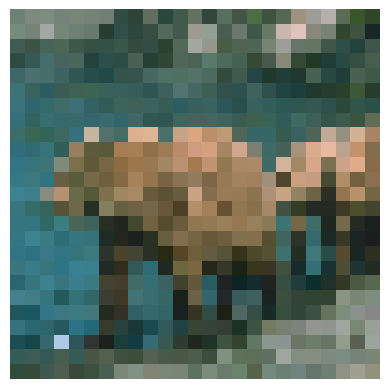

Image 2 - Size: (25, 25)


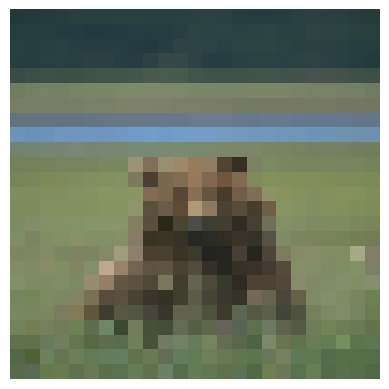

Image 3 - Size: (25, 25)


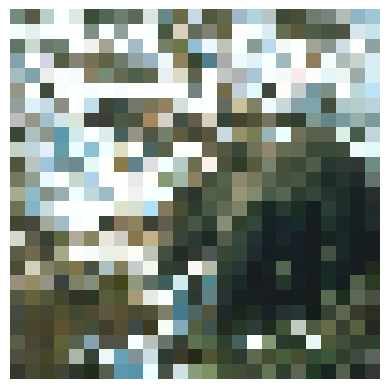

Image 4 - Size: (25, 25)


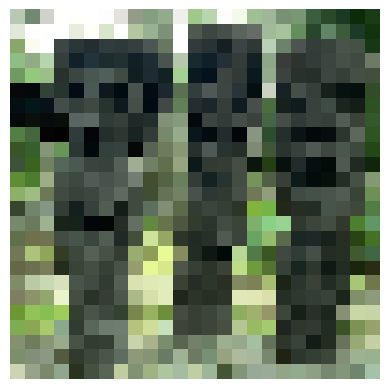

Image 5 - Size: (25, 25)


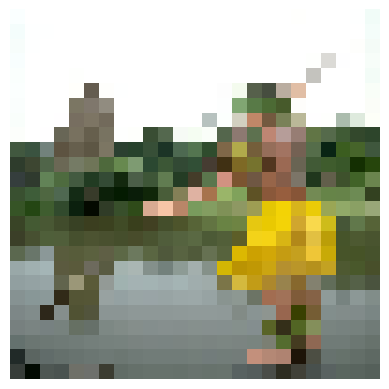

In [ ]:
from PIL import Image

def print_images(directory):
    # Get a list of image file names in the directory
    image_files = [file for file in os.listdir(directory) if file.endswith(('.jpg', '.png'))]

    # Print the size and display a few images
    num_images = min(5, len(image_files))  # Print at most 5 images
    print(f"Printing {num_images} images from directory: {directory}")
    for i in range(num_images):
        image_path = os.path.join(directory, image_files[i])
        image = Image.open(image_path)
        print(f"Image {i + 1} - Size: {image.size}")
        plt.imshow(image)
        plt.axis("off")
        plt.show()

# Print LR images
print_images(lr_directory)

# Print HR images


Printing 5 images from directory: Data/SRGAN_Data/HR
Image 1 - Size: (100, 100)


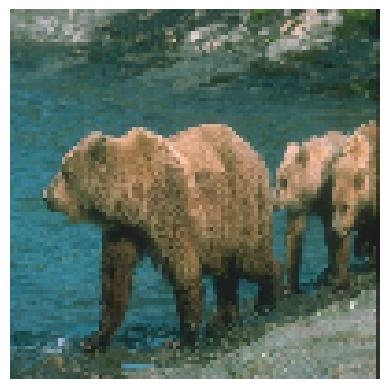

Image 2 - Size: (100, 100)


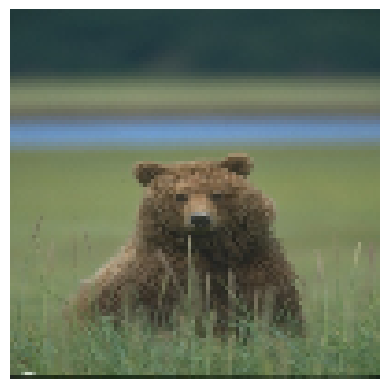

Image 3 - Size: (100, 100)


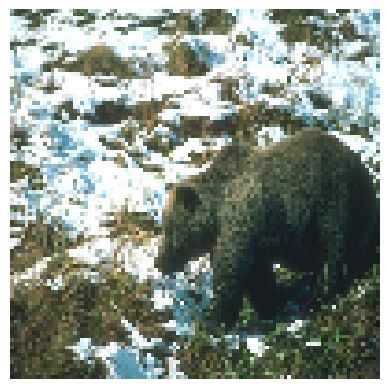

Image 4 - Size: (100, 100)


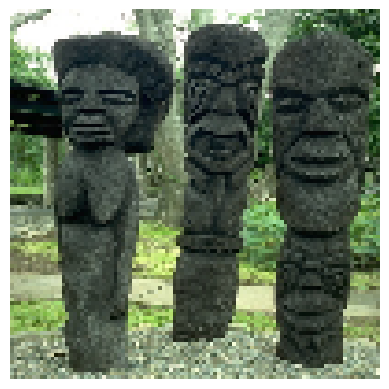

Image 5 - Size: (100, 100)


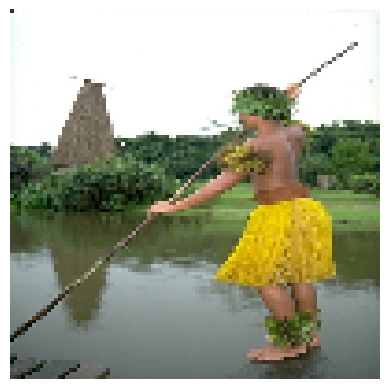

In [ ]:
print_images(hr_directory)

# Training Loop

In [ ]:

# Define transformations
transform = ToTensor()

# Instantiate custom dataset
custom_dataset = CustomSRDataset(lr_directory, hr_directory, transform=transform)

# Define batch size and create DataLoader
batch_size = 16
data_loader = DataLoader(custom_dataset, batch_size=batch_size, shuffle=True)

# Define device (CPU or GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Move models to device
generator.to(device)
discriminator.to(device)

# Define optimizers
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Define number of epochs
num_epochs = 1000
generator_losses = []
discriminator_losses = []
# Training loop
for epoch in range(num_epochs):
    for i, (lr_images, hr_images) in enumerate(data_loader):
        # Adversarial ground truths
        valid = torch.ones(lr_images.size(0), 1, requires_grad=False).to(device)
        fake = torch.zeros(lr_images.size(0), 1, requires_grad=False).to(device)

        # Move LR and HR images to device
        lr_images = lr_images.to(device)
        hr_images = hr_images.to(device)

        # Train Generator
        optimizer_G.zero_grad()
        generated_hr = generator(lr_images)
        g_content_loss = content_loss(generated_hr, hr_images)
        g_adversarial_loss = adversarial_loss(discriminator(generated_hr), valid)
        g_loss = g_content_loss + 0.001 * g_adversarial_loss
        g_loss.backward()
        optimizer_G.step()

        # Train Discriminator
        optimizer_D.zero_grad()
        d_real_loss = adversarial_loss(discriminator(hr_images), valid)
        d_fake_loss = adversarial_loss(discriminator(generated_hr.detach()), fake)
        d_loss = (d_real_loss + d_fake_loss) / 2
        d_loss.backward()
        optimizer_D.step()

        generator_losses.append(g_loss.item())
        discriminator_losses.append(d_loss.item())

        # Print training progress
        if i % 100 == 0:
            print(
                "[Epoch %d/%d] [Batch %d/%d] [D loss: %f] [G loss: %f]"
                % (epoch, num_epochs, i, len(data_loader), d_loss.item(), g_loss.item())
            )

    # Optionally, save some generated images for visual inspection
    if epoch % 10 == 0:
        save_image(generated_hr, f"generated_images_epoch_{epoch}.png")



[Epoch 0/1000] [Batch 0/32] [D loss: 0.689725] [G loss: 0.321037]
[Epoch 1/1000] [Batch 0/32] [D loss: 0.083614] [G loss: 0.476202]
[Epoch 2/1000] [Batch 0/32] [D loss: 0.037145] [G loss: 0.353214]
[Epoch 3/1000] [Batch 0/32] [D loss: 0.017303] [G loss: 0.449664]
[Epoch 4/1000] [Batch 0/32] [D loss: 0.078173] [G loss: 0.438448]
[Epoch 5/1000] [Batch 0/32] [D loss: 0.105183] [G loss: 0.342378]
[Epoch 6/1000] [Batch 0/32] [D loss: 0.020304] [G loss: 0.329941]
[Epoch 7/1000] [Batch 0/32] [D loss: 0.036088] [G loss: 0.279858]
[Epoch 8/1000] [Batch 0/32] [D loss: 0.295446] [G loss: 0.355919]
[Epoch 9/1000] [Batch 0/32] [D loss: 0.000845] [G loss: 0.407454]
[Epoch 10/1000] [Batch 0/32] [D loss: 0.024316] [G loss: 0.406871]
[Epoch 11/1000] [Batch 0/32] [D loss: 0.036996] [G loss: 0.226373]
[Epoch 12/1000] [Batch 0/32] [D loss: 2.171815] [G loss: 0.408722]
[Epoch 13/1000] [Batch 0/32] [D loss: 0.041558] [G loss: 0.355119]
[Epoch 14/1000] [Batch 0/32] [D loss: 0.003525] [G loss: 0.365180]
[Epoc

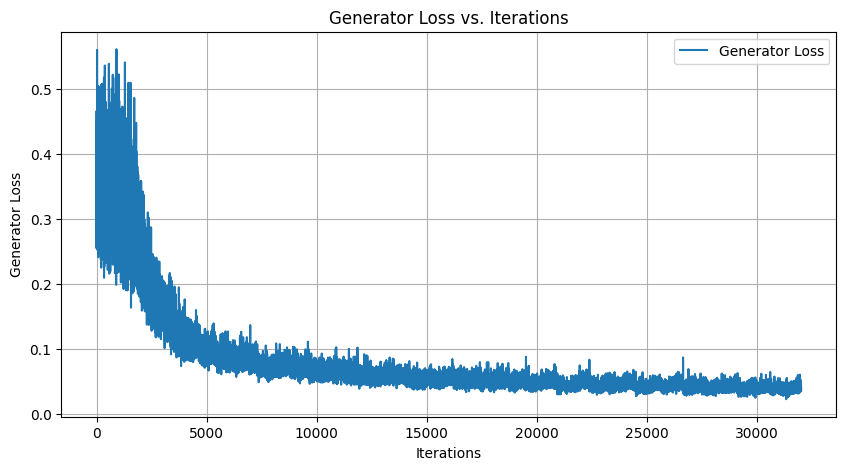

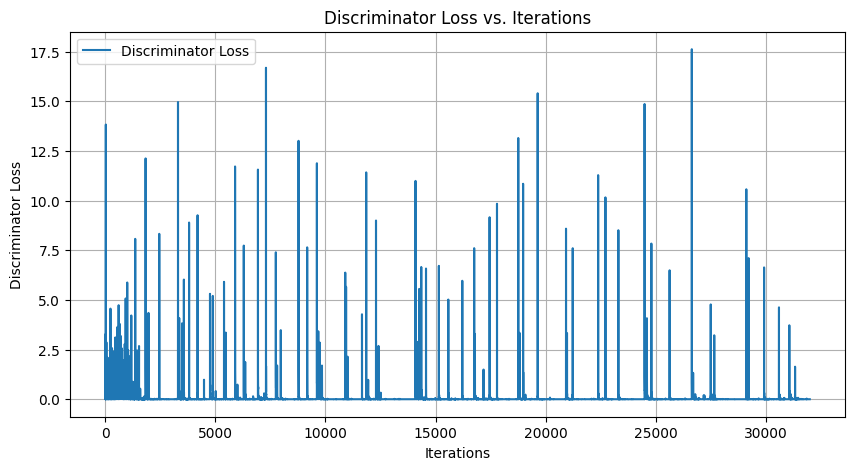

In [ ]:
import matplotlib.pyplot as plt
# Plot generator loss versus epochs
plt.figure(figsize=(10, 5))
plt.plot(range(len(generator_losses)), generator_losses, label='Generator Loss')
plt.xlabel('Iterations')
plt.ylabel('Generator Loss')
plt.title('Generator Loss vs. Iterations')
plt.legend()
plt.grid(True)
plt.show()

# Plot discriminator loss versus epochs
plt.figure(figsize=(10, 5))
plt.plot(range(len(discriminator_losses)), discriminator_losses, label='Discriminator Loss')
plt.xlabel('Iterations')
plt.ylabel('Discriminator Loss')
plt.title('Discriminator Loss vs. Iterations')
plt.legend()
plt.grid(True)
plt.show()


# Saving the model

In [ ]:
# Define the path where you want to save the weights
weights_path = "generator_weights.pth"  # Update with your desired path

# Save the state dictionary of the generator model
torch.save(generator.state_dict(), weights_path)

print("Generator weights saved successfully.")

Generator weights saved successfully.


In [ ]:
!pip install matplotlib

In [ ]:
# # Plot losses versus epochs
# import matplotlib.pyplot as plt
# plt.figure(figsize=(10, 5))
# plt.plot(range(num_epochs), generator_losses, label='Generator Loss')
# plt.plot(range(num_epochs), discriminator_losses, label='Discriminator Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.title('Generator and Discriminator Losses vs. Epochs')
# plt.legend()
# plt.grid(True)
# plt.show()

# loading the model

In [ ]:

generator = Generator()
generator.load_state_dict(torch.load('generator_weights.pth', map_location=torch.device('cpu')))  # Load the trained weights
generator.eval()

# # Define the directory containing the test images
# test_dir = r"Data/SRGAN_Data/Test"  # Update with your test images directory

# # Ensure the output directory exists
# output_dir = "Data/SRGAN_Data/Output_dir"
# os.makedirs(output_dir, exist_ok=True)

# # Define transformation
# transform = ToTensor()

# # Loop through each image in the test directory
# for filename in os.listdir(test_dir):
#     if filename.endswith(".jpg") or filename.endswith(".png"):
#         # Load and preprocess the test image
#         test_image_path = os.path.join(test_dir, filename)
#         test_image = Image.open(test_image_path).convert("RGB")
#         input_tensor = transform(test_image).unsqueeze(0)

#         # Perform inference
#         with torch.no_grad():
#             generated_image = generator(input_tensor)

#         # Convert the generated image tensor to a numpy array and then to a PIL image
#         generated_image = generated_image.squeeze(0).permute(1, 2, 0).clamp(0, 1).numpy()  # Assuming the image is in range [0, 1]
#         generated_image = (generated_image * 255).astype('uint8')  # Convert to uint8 for PIL
#         generated_image = Image.fromarray(generated_image)

#         # Save the generated high-resolution image
#         output_image_path = os.path.join(output_dir, filename)
#         generated_image.save(output_image_path)

#         print(f"Generated image saved: {output_image_path}")

# print("All test images processed.")

Generator(
  (initial): ConvBlock(
    (cnn): Conv2d(3, 64, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
    (bn): Identity()
    (act): PReLU(num_parameters=64)
  )
  (residuals): Sequential(
    (0): ResidualBlock(
      (block1): ConvBlock(
        (cnn): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (act): PReLU(num_parameters=64)
      )
      (block2): ConvBlock(
        (cnn): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (act): PReLU(num_parameters=64)
      )
    )
    (1): ResidualBlock(
      (block1): ConvBlock(
        (cnn): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (

# Testing the model

In [ ]:

# Define the directory containing the test images
test_dir = r"Data/SRGAN_Data/Test"  # Update with your test images directory

# Ensure the output directory exists
output_dir = "Data/SRGAN_Data/Output_dir"
os.makedirs(output_dir, exist_ok=True)

# Define transformation
transform = ToTensor()

# Loop through each image in the test directory
for filename in os.listdir(test_dir):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Load and preprocess the test image
        test_image_path = os.path.join(test_dir, filename)
        test_image = Image.open(test_image_path).convert("RGB")

        # Print original image size
        original_size = test_image.size
        print(f"Original image size: {original_size}")

        input_tensor = transform(test_image).unsqueeze(0)

        # Perform inference
        with torch.no_grad():
            generated_image = generator(input_tensor)

        # Convert the generated image tensor to a numpy array and then to a PIL image
        generated_image = generated_image.squeeze(0).permute(1, 2, 0).clamp(0, 1).numpy()  # Assuming the image is in range [0, 1]
        generated_image = (generated_image * 255).astype('uint8')  # Convert to uint8 for PIL
        generated_image = Image.fromarray(generated_image)

        # Save the generated high-resolution image
        output_image_path = os.path.join(output_dir, filename)
        generated_image.save(output_image_path)

        # Print output image size and file name
        output_size = generated_image.size
        print(f"Output image size: {output_size}")
        print(f"Generated image saved: {output_image_path}\n")

print("All test images processed.")


Original image size: (512, 512)
Output image size: (2048, 2048)
Generated image saved: Data/SRGAN_Data/Output_dir/baby.png

Original image size: (288, 288)
Output image size: (1152, 1152)
Generated image saved: Data/SRGAN_Data/Output_dir/bird.png

Original image size: (256, 256)
Output image size: (1024, 1024)
Generated image saved: Data/SRGAN_Data/Output_dir/butterfly.png

Original image size: (280, 280)
Output image size: (1120, 1120)
Generated image saved: Data/SRGAN_Data/Output_dir/head.png

Original image size: (224, 344)
Output image size: (896, 1376)
Generated image saved: Data/SRGAN_Data/Output_dir/woman.png

All test images processed.


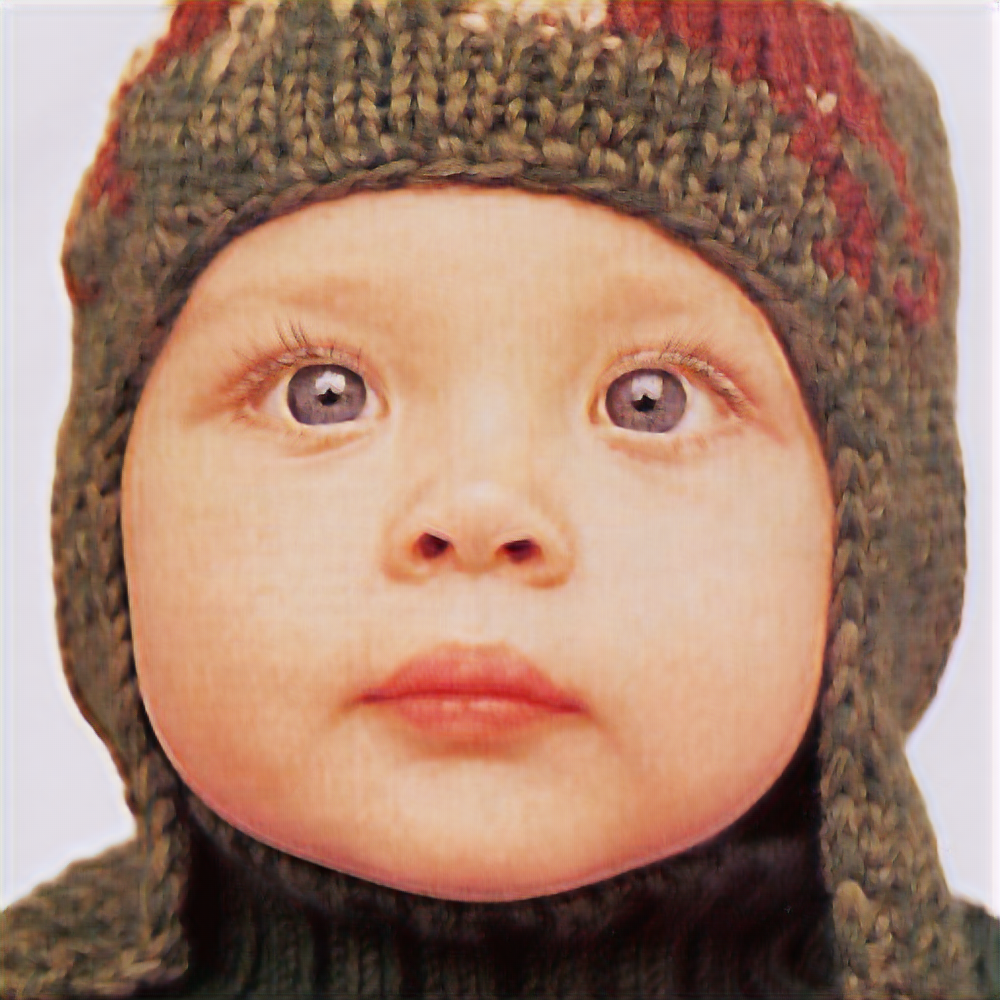

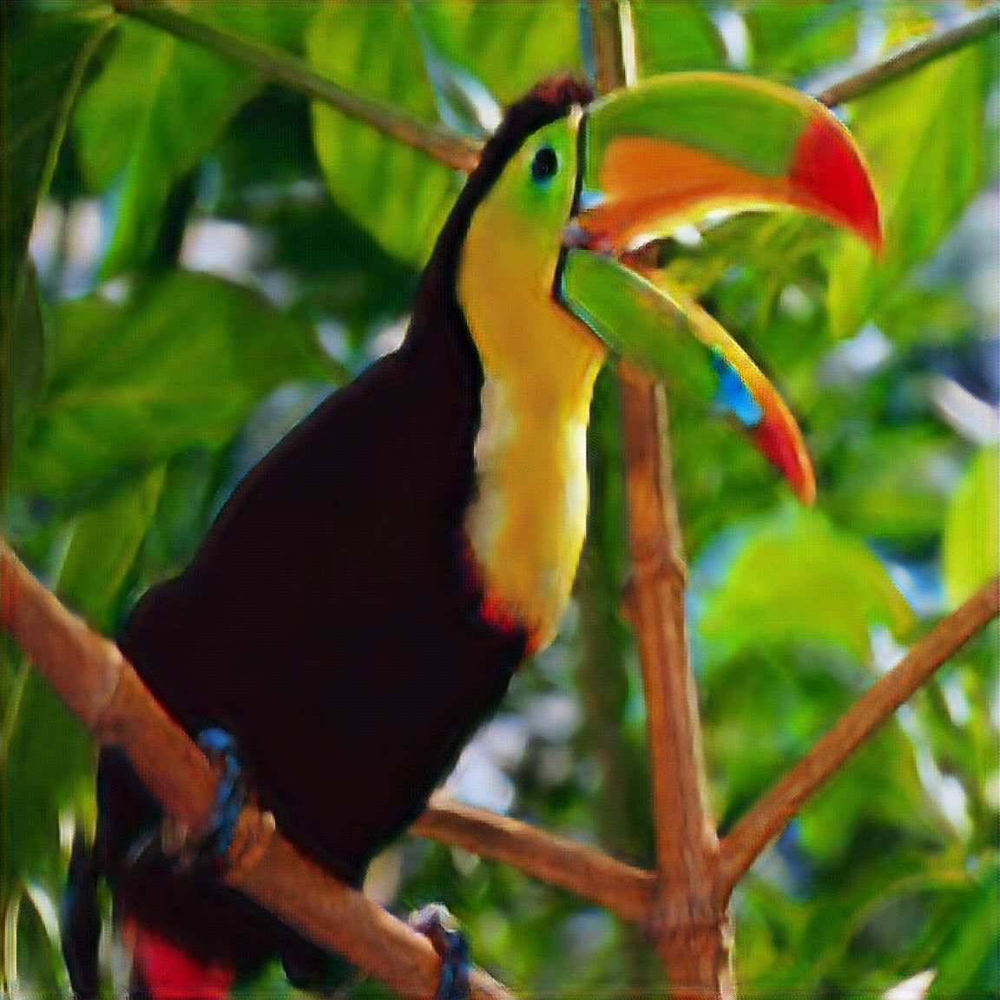

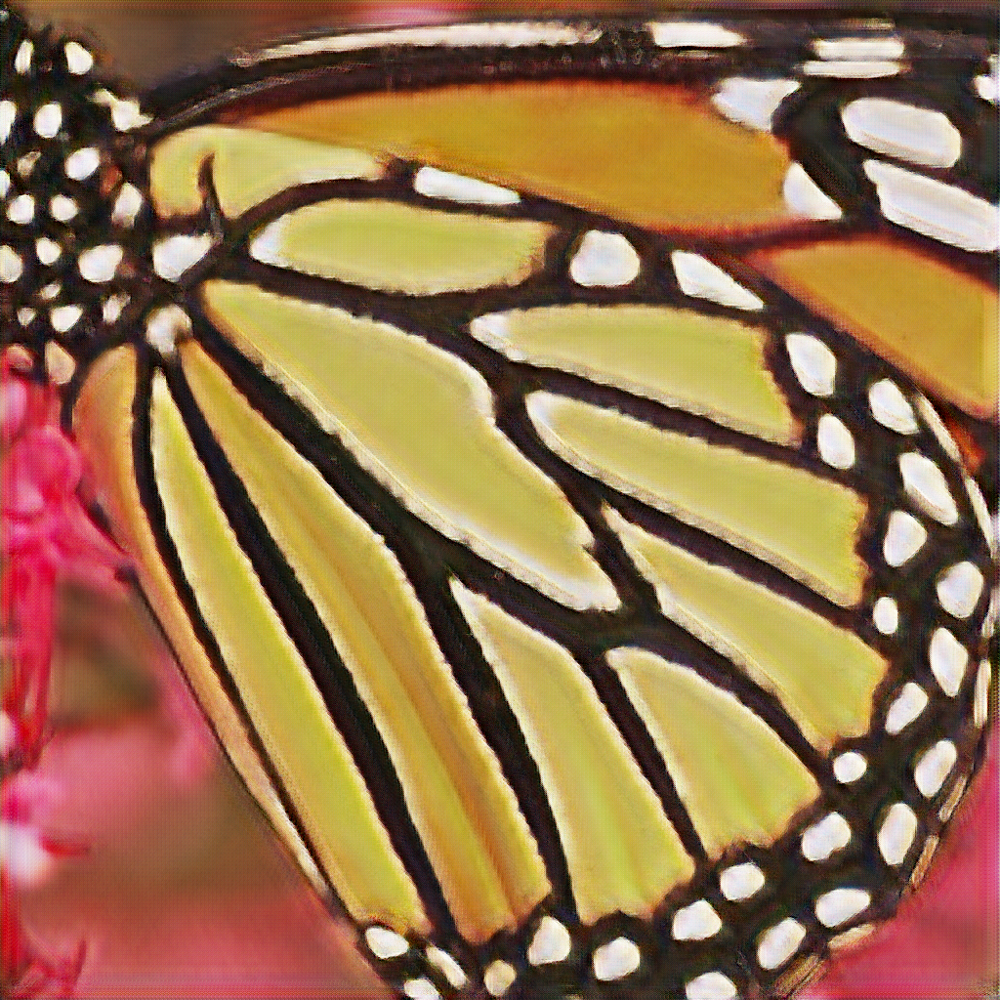

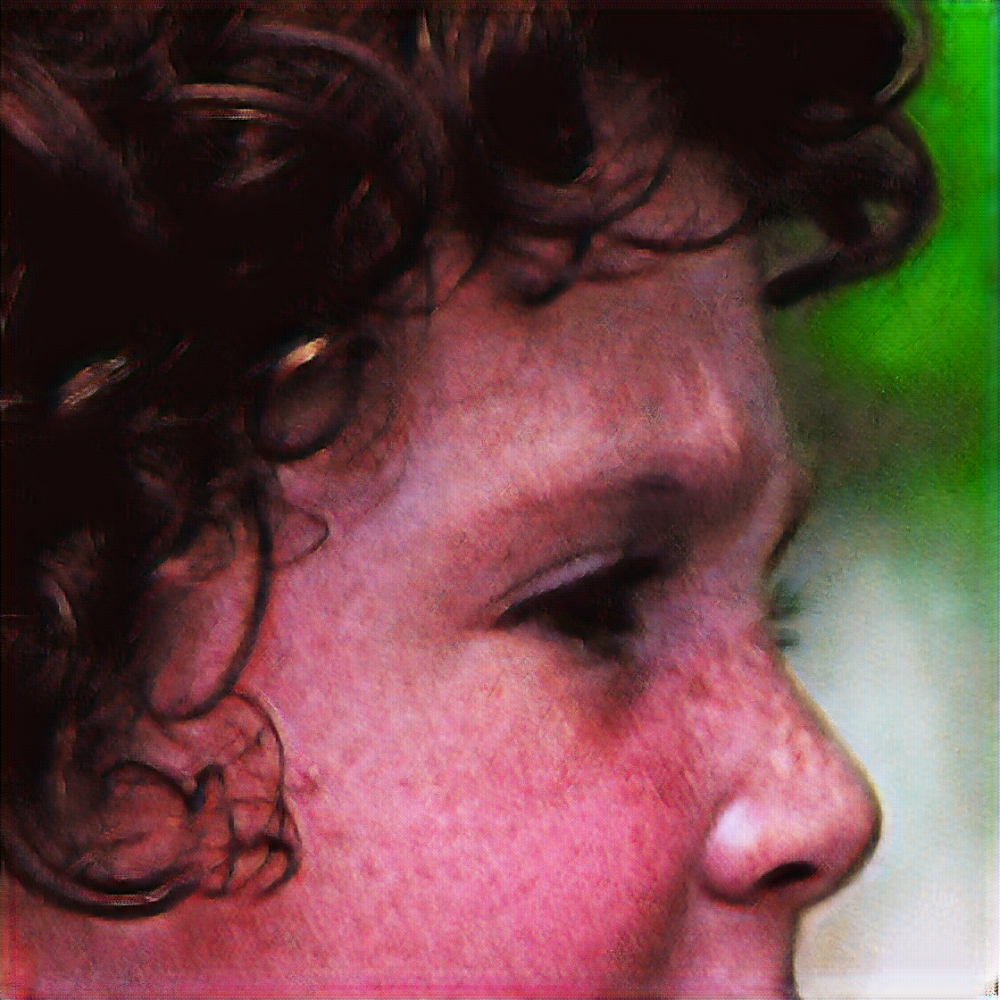

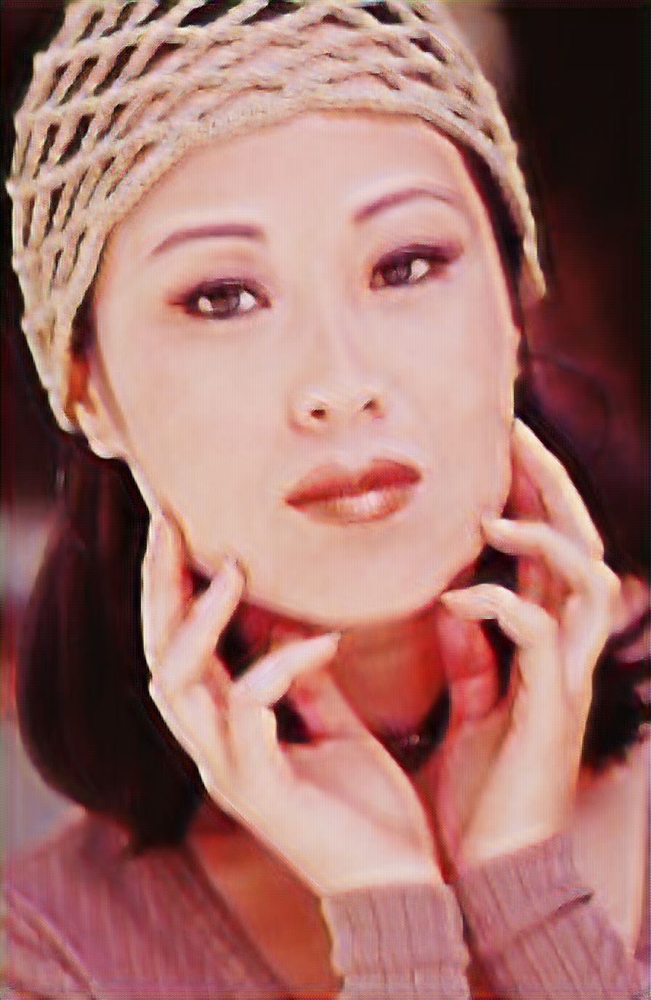

In [ ]:
from IPython.display import Image, display
import os

# Define the directory containing the generated images
output_dir = "Data/SRGAN_Data/Output_dir"  # Update with your output directory

# Display each generated image
for filename in os.listdir(output_dir):
    if filename.endswith(".png"):
        display(Image(os.path.join(output_dir, filename)))